In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from mpl_toolkits.axes_grid1 import make_axes_locatable


from ipywidgets import interact, fixed
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
from matplotlib.patches import Ellipse
from scipy import linalg

#import plotly.express as px
import urllib.request
import zipfile
from matplotlib.colors import ListedColormap
import matplotlib.colors as mcolors
from matplotlib.ticker import FuncFormatter
from sklearn.decomposition import PCA, FactorAnalysis
from factor_analyzer import FactorAnalyzer, calculate_kmo, calculate_bartlett_sphericity
from sklearn.preprocessing import StandardScaler
from factor_analyzer import FactorAnalyzer

import os
# os.environ["OMP_NUM_THREADS"] = "2"

from sklearn.mixture import GaussianMixture
from sklearn.model_selection import GridSearchCV

from sklearn.preprocessing import StandardScaler
from sklearn.datasets import make_regression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, mean_absolute_percentage_error, mean_squared_error

import pandas as pd
import ast
import numpy as np
from pathlib import Path  
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
import geopandas as gpd
import pandas as pd
import matplotlib.patches as mpatches
from matplotlib.lines import Line2D
import seaborn as sns
import matplotlib.pyplot as plt
from adjustText import adjust_text
from matplotlib.patches import Patch
from sklearn.decomposition import PCA, FactorAnalysis
import matplotlib.colors as mcolors
from matplotlib.ticker import FuncFormatter


import warnings
warnings.filterwarnings("ignore", message="KMeans is known to have a memory leak")


C:\Users\peiyaozhao\AppData\Local\anaconda3\Lib\site-packages\pandas\core\arrays\masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (


In [2]:
data = pd.read_csv('../../results/cluster-msa.csv')
new_df = pd.read_csv('../../results/cluster-msa-emissions.csv')

In [3]:
divid_df=data.copy(deep=True)

# Extract city and state from MSA in df1
divid_df[['Area', 'State']] = divid_df['MSA'].str.split(', ', expand=True)
divid_df['Area'] = divid_df['Area'].str.split('-').str[0]

In [4]:
cities_gdf  = gpd.read_file('../../data/raw/USA_Major_Cities/USA_Major_Cities.shp')
cities_gdf 

,FID,NAME,CLASS,ST,STFIPS,PLACEFIPS,CAPITAL,POP_CLASS,POPULATION,POP2010,...,MARHH_NO_C,MHH_CHILD,FHH_CHILD,FAMILIES,AVE_FAM_SZ,HSE_UNITS,VACANT,OWNER_OCC,RENTER_OCC,geometry
0,1,Ammon,city,ID,16,1601990,None,6,15181,13816,...,1131,106,335,3352,3.61,4747,271,3205,1271,POINT (-111.95410 43.47579)
1,2,Blackfoot,city,ID,16,1607840,None,6,11946,11899,...,1081,174,381,2958,3.31,4547,318,2788,1441,POINT (-112.34557 43.19394)
2,3,Boise City,city,ID,16,1608830,State,8,225405,205671,...,21233,2414,5919,50647,2.97,92700,6996,52345,33359,POINT (-116.23011 43.59901)
3,4,Burley,city,ID,16,1611260,None,6,10727,10345,...,861,139,358,2499,3.37,3885,241,2183,1461,POINT (-113.79329 42.53674)
4,5,Caldwell,city,ID,16,1612250,None,7,53942,46237,...,3113,686,1755,10776,3.51,16323,1428,9699,5196,POINT (-116.68562 43.66163)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3881,3882,Herndon,town,VA,51,5136648,None,6,23993,23292,...,1848,306,525,5357,3.46,7813,341,4558,2914,POINT (-77.38672 38.96993)
3882,3883,Highland Springs,Census Designated Place,VA,51,5137032,None,6,16618,15711,...,1187,206,1323,4157,3.03,6621,513,3795,2313,POINT (-77.32854 37.55172)
3883,3884,Hollins,Census Designated Place,VA,51,5137880,None,6,15033,14673,...,1806,115,413,3800,2.87,6435,385,4361,1689,POINT (-79.95348 37.34338)
3884,3885,Hopewell,city,VA,51,5138424,None,6,22935,22591,...,1963,305,1465,5877,3.00,10121,992,4906,4223,POINT (-77.29837 37.29038)


In [5]:
# Replace 'your_shapefile_path' with the path to your shapefile
gdf = gpd.read_file('../../data/raw/cb_2018_us_cbsa_500k/cb_2018_us_cbsa_500k.shp')
us_state = gpd.read_file('../../data/raw/cb_2018_us_state_500k/cb_2018_us_state_500k.shp')
# Filter for Metropolitan Statistical Areas (MSA)
msa_gdf = gdf[(gdf['CBSAFP'].notnull()) & (gdf['LSAD'] == 'M1')]

# Extract city and state from NAME in df2
msa_gdf[['Area', 'State']] = msa_gdf['NAME'].str.split(', ', expand=True)
msa_gdf['Area'] = msa_gdf['Area'].str.split('-').str[0]
msa_gdf

C:\Users\peiyaozhao\AppData\Local\anaconda3\Lib\site-packages\geopandas\geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
C:\Users\peiyaozhao\AppData\Local\anaconda3\Lib\site-packages\geopandas\geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


,CSAFP,CBSAFP,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry,Area,State
0,None,31340,310M400US31340,31340,"Lynchburg, VA",M1,5491925729,68559452,"POLYGON ((-79.85840 37.26715, -79.85660 37.268...",Lynchburg,VA
1,488,42220,310M400US42220,42220,"Santa Rosa, CA",M1,4081491107,497455304,"POLYGON ((-123.53354 38.76841, -123.52851 38.7...",Santa Rosa,CA
3,538,46140,310M400US46140,46140,"Tulsa, OK",M1,16238554204,492994165,"POLYGON ((-97.06448 36.68106, -97.06411 36.684...",Tulsa,OK
5,None,41740,310M400US41740,41740,"San Diego-Carlsbad, CA",M1,10900649391,820695499,"POLYGON ((-117.59615 33.38717, -117.59360 33.3...",San Diego,CA
8,340,38220,310M400US38220,38220,"Pine Bluff, AR",M1,5255934204,143446207,"POLYGON ((-92.47391 34.00623, -92.47241 34.038...",Pine Bluff,AR
...,...,...,...,...,...,...,...,...,...,...,...
934,None,42020,310M400US42020,42020,"San Luis Obispo-Paso Robles-Arroyo Grande, CA",M1,8548611925,815519172,"POLYGON ((-121.34636 35.79518, -121.24378 35.7...",San Luis Obispo,CA
936,None,49740,310M400US49740,49740,"Yuma, AZ",M1,14281127830,13326079,"POLYGON ((-114.81629 32.50804, -114.81432 32.5...",Yuma,AZ
938,222,20020,310M400US20020,20020,"Dothan, AL",M1,4444678880,33248036,"POLYGON ((-86.19348 31.19221, -86.14167 31.192...",Dothan,AL
939,408,14860,310M400US14860,14860,"Bridgeport-Stamford-Norwalk, CT",M1,1618651428,549293518,"MULTIPOLYGON (((-73.21717 41.14391, -73.21611 ...",Bridgeport,CT


In [6]:
if isinstance(divid_df.columns, pd.MultiIndex):
    divid_df.columns = divid_df.columns.get_level_values(0)
if isinstance(msa_gdf.columns, pd.MultiIndex):
    msa_gdf.columns = msa_gdf.columns.get_level_values(0)

# Merge the dataframes on the 'Area' and 'State' columns
merged_df = msa_gdf.merge(divid_df, on=['Area', 'State'], suffixes=('_pivot', '_msa'))
merged_df

,CSAFP,CBSAFP,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry,Area,...,MSA,carbon dioxide equivalent (Ton),Size--Auto,Public Transportation,Transit Alternative Fuel,Density,Active Mobility,Network Connectivity,Network Compactness,Cluster
0,488,42220,310M400US42220,42220,"Santa Rosa, CA",M1,4081491107,497455304,"POLYGON ((-123.53354 38.76841, -123.52851 38.7...",Santa Rosa,...,"Santa Rosa-Petaluma, CA",2.130224e+06,-0.442451,-0.004047,0.165429,-0.358180,0.834247,-1.175155,0.975784,1
1,538,46140,310M400US46140,46140,"Tulsa, OK",M1,16238554204,492994165,"POLYGON ((-97.06448 36.68106, -97.06411 36.684...",Tulsa,...,"Tulsa, OK",6.939685e+06,1.523463,-0.389664,-1.165643,-0.350318,-0.678919,-0.012653,0.472247,5
2,None,41740,310M400US41740,41740,"San Diego-Carlsbad, CA",M1,10900649391,820695499,"POLYGON ((-117.59615 33.38717, -117.59360 33.3...",San Diego,...,"San Diego-Chula Vista-Carlsbad, CA",1.673588e+07,0.215365,0.104024,2.780266,-0.174438,0.963534,-0.874193,0.964914,7
3,340,38220,310M400US38220,38220,"Pine Bluff, AR",M1,5255934204,143446207,"POLYGON ((-92.47391 34.00623, -92.47241 34.038...",Pine Bluff,...,"Pine Bluff, AR",7.791471e+05,-0.088948,0.024617,-0.027455,-0.507161,-1.457494,-0.622676,-0.781182,4
4,None,17020,310M400US17020,17020,"Chico, CA",M1,4238438186,105311003,"POLYGON ((-122.06874 39.84222, -122.06694 39.8...",Chico,...,"Chico, CA",1.182906e+06,-0.405165,0.001967,-0.101584,-0.299432,0.715881,-1.475741,-0.156537,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
347,None,42020,310M400US42020,42020,"San Luis Obispo-Paso Robles-Arroyo Grande, CA",M1,8548611925,815519172,"POLYGON ((-121.34636 35.79518, -121.24378 35.7...",San Luis Obispo,...,"San Luis Obispo-Paso Robles, CA",1.256077e+06,-0.254141,-0.015640,-0.101944,-1.227329,1.392291,-0.725550,0.342979,1
348,None,49740,310M400US49740,49740,"Yuma, AZ",M1,14281127830,13326079,"POLYGON ((-114.81629 32.50804, -114.81432 32.5...",Yuma,...,"Yuma, AZ",1.288764e+06,-0.136282,0.063852,0.165466,-1.878342,-0.400073,0.916167,0.678052,1
349,222,20020,310M400US20020,20020,"Dothan, AL",M1,4444678880,33248036,"POLYGON ((-86.19348 31.19221, -86.14167 31.192...",Dothan,...,"Dothan, AL",1.124121e+06,-0.131854,-0.002914,-0.086716,-0.290945,-1.414871,0.612840,-0.268163,4
350,408,14860,310M400US14860,14860,"Bridgeport-Stamford-Norwalk, CT",M1,1618651428,549293518,"MULTIPOLYGON (((-73.21717 41.14391, -73.21611 ...",Bridgeport,...,"Bridgeport-Stamford-Norwalk, CT",4.288006e+06,-1.126498,-0.182895,0.072732,4.050455,2.274730,-0.387779,-0.961063,5


In [7]:
merged_df['Emissions per capita']=new_df['Emissions per capita (MTCO2e)']

In [8]:
merged_df['greenhouse gas emissions (MMTCO2e)']=merged_df['carbon dioxide equivalent (Ton)']/1102311.31

In [9]:
# Define the list of major cities with state abbreviations
major_cities = [
    ('Chicago', 'IL'), ('New York', 'NY'), ('Los Angeles', 'CA'), ('Houston', 'TX'), ('Michigan', 'MI'), 
    ('Minneapolis', 'MN'), ('Atlanta', 'GA'), ('San Francisco', 'CA'), ('Dallas', 'TX'), ('St. Louis', 'MO'),
    ('Phoenix', 'AZ'), ('Miami', 'FL'),('Las Vegas','NV'),('Portland','OR'),('Seattle','WA'),('Boston','MA'),('San Diego', 'CA'), ('Denver', 'CO'), ('Baltimore', 'MD'), ('Cleveland', 'OH'), ('Orlando', 'FL'),
    ('Charlotte', 'NC'), ('Indianapolis', 'IN'), ('Nashville', 'TN'), ('Kansas City', 'MO'), ('Columbus', 'OH'),
    ('Austin', 'TX'), ('Omaha', 'NE'), ('Memphis', 'TN'), ('Louisville', 'KY'), ('Chicago', 'IL'), ('St. Louis', 'MO'), ('Kansas City', 'MO'), ('Oklahoma City', 'OK'),
    ('Indianapolis', 'IN'), ('Columbus', 'OH'), ('Cleveland', 'OH'), ('Minneapolis', 'MN'), ('Milwaukee', 'WI'),
    ('Dallas', 'TX'), ('Houston', 'TX'), ('Austin', 'TX'), ('San Antonio', 'TX'), ('Memphis', 'TN'),('Billings', 'MT'), ('Missoula', 'MT'),
    ('Cheyenne', 'WY'), ('Casper', 'WY'),
    ('Boise', 'ID'), ('Idaho Falls', 'ID'),
    ('Denver', 'CO'), ('Colorado Springs', 'CO'), 
    ('Salt Lake City', 'UT'), 
    ('Albuquerque', 'NM'), 
    ('Phoenix', 'AZ'), ('Tucson', 'AZ'),
    ('Fargo', 'ND'), ('Bismarck', 'ND'),
    ('Sioux Falls', 'SD'), ('Rapid City', 'SD'),
    ('Omaha', 'NE'), 
    ('Wichita', 'KS'), 
    ('Oklahoma City', 'OK'), ('Tulsa', 'OK'),('Reno', 'NV'),
    ('Burlington', 'VT'),
    ('Portland', 'ME')
]

# Filter the major cities including the specific Dallas, TX
cities_gdf_filtered = cities_gdf[cities_gdf.apply(lambda row: (row['NAME'], row['ST']) in major_cities, axis=1)]

# Filter out only the Dallas in Texas
dallas_tx = cities_gdf[(cities_gdf['NAME'] == 'Dallas') & (cities_gdf['ST'] == 'TX')]

# Combine the filtered Dallas entry with the other cities
cities_gdf_filtered = pd.concat([cities_gdf_filtered, dallas_tx]).drop_duplicates()

# Ensure CRS matches
cities_gdf_filtered = cities_gdf_filtered.to_crs(epsg=4326)

# Set the theme
sns.set_theme(style="white")

# Create the figure and axis
fig, ax = plt.subplots(figsize=(40, 30), dpi=600)

# Ensure both DataFrames use the same CRS
us_state = us_state.to_crs(epsg=4326)
merged_df = merged_df.to_crs(epsg=4326)

# Filter out Alaska
us_state = us_state[us_state['NAME'] != 'Alaska']

us_state.plot(ax=ax, alpha=0.2, facecolor='white', edgecolor='black')

# Plot the heatmap with adjusted boundary color
merged_df.plot(ax=ax, alpha=0.8, column='greenhouse gas emissions (MMTCO2e)', cmap='YlOrRd', legend=False, edgecolor='black', linewidth=0.5)

# Plot the major cities
cities_gdf_filtered.plot(ax=ax, color='blue', markersize=100)

# Annotate the cities underneath the markers
for idx, row in cities_gdf_filtered.iterrows():
    ax.annotate(row['NAME'], 
                xy=(row.geometry.x, row.geometry.y), 
                xytext=(0, -20),  # Offset label below the marker
                textcoords='offset points', 
                fontsize=30, 
                color='blue', 
                ha='center')  # Horizontal alignment to center the text

# Customize the plot
plt.xlabel('')
plt.ylabel('')
plt.title('')
plt.xlim(-128, -60)
plt.ylim(20, 50)
plt.grid(False)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_visible(False)
plt.gca().spines['left'].set_visible(False)
plt.tick_params(axis='both', which='both', length=0)
plt.tick_params(axis='both', which='both', labelsize=0)

# Add colorbar with a smaller size
cax = fig.add_axes([0.2, 0.23, 0.6, 0.02])
sm = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=merged_df['greenhouse gas emissions (MMTCO2e)'].min(), vmax=merged_df['greenhouse gas emissions (MMTCO2e)'].max()))
sm._A = []
colorbar = fig.colorbar(sm, cax=cax, orientation='horizontal')

# Add unit label to the colorbar
colorbar.set_label('Greenhouse Gas Emissions (MMTCO$_{2}$e)', size=30)

colorbar.ax.tick_params(labelsize=30)

# Adjust layout to minimize white space
plt.tight_layout()

# Optionally, adjust subplot parameters to further reduce white space
fig.subplots_adjust(left=0.05, right=0.95, top=0.95, bottom=0.05)

# Save the figure
plt.savefig('../../figures/greenhousegas-heatmap.jpg', dpi=600, bbox_inches='tight', pad_inches=0)

C:\Users\peiyaozhao\AppData\Local\Temp\ipykernel_11688\2686995142.py:94: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


In [10]:
# # Define the list of major cities with state abbreviations
# major_cities = [
#     ('Chicago', 'IL'), ('New York', 'NY'), ('Los Angeles', 'CA'), ('Houston', 'TX'), ('Michigan', 'MI'), 
#     ('Minneapolis', 'MN'), ('Atlanta', 'GA'), ('San Francisco', 'CA'), ('Dallas', 'TX'), ('St. Louis', 'MO'),
#     ('Phoenix', 'AZ'), ('Miami', 'FL'), ('Las Vegas', 'NV'), ('Portland', 'OR'), ('Seattle', 'WA'), ('Boston', 'MA')
# ]

# # Filter the major cities
# cities_gdf_filtered = cities_gdf[cities_gdf.apply(lambda row: (row['NAME'], row['ST']) in major_cities, axis=1)]

# # Ensure CRS matches
# cities_gdf_filtered = cities_gdf_filtered.to_crs(epsg=4326)

# Set the theme
sns.set_theme(style="white")

# Create the figure and axis
fig, ax = plt.subplots(figsize=(40, 30), dpi=600)

# Ensure both DataFrames use the same CRS
us_state = us_state.to_crs(epsg=4326)
merged_df = merged_df.to_crs(epsg=4326)

# Filter out Alaska
us_state = us_state[us_state['NAME'] != 'Alaska']

us_state.plot(ax=ax, alpha=0.2, facecolor='white', edgecolor='black')

# Plot the heatmap with adjusted boundary color
merged_df.plot(ax=ax, alpha=0.8, column='Emissions per capita', cmap='YlOrRd', legend=False, edgecolor='black', linewidth=0.5)

# Plot the major cities
cities_gdf_filtered.plot(ax=ax, color='blue', markersize=100)

# Annotate the cities underneath the markers
for idx, row in cities_gdf_filtered.iterrows():
    ax.annotate(row['NAME'], 
                xy=(row.geometry.x, row.geometry.y), 
                xytext=(0, -20),  # Offset label below the marker
                textcoords='offset points', 
                fontsize=25, 
                color='blue', 
                ha='center')  # Horizontal alignment to center the text

# Customize the plot
plt.xlabel('')
plt.ylabel('')
plt.title('')
plt.xlim(-128, -60)
plt.ylim(20, 50)
plt.grid(False)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_visible(False)
plt.gca().spines['left'].set_visible(False)
plt.tick_params(axis='both', which='both', length=0)
plt.tick_params(axis='both', which='both', labelsize=0)

# Add colorbar with a smaller size
cax = fig.add_axes([0.2, 0.23, 0.6, 0.02])
sm = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=merged_df['Emissions per capita'].min(), vmax=merged_df['Emissions per capita'].max()))
sm._A = []
colorbar = fig.colorbar(sm, cax=cax, orientation='horizontal')

# Add unit label to the colorbar
colorbar.set_label('Greenhouse Gas Per-capita Emissions (MTCO$_{2}$e)', size=30)

colorbar.ax.tick_params(labelsize=30)

# Adjust layout to minimize white space
plt.tight_layout()

# Optionally, adjust subplot parameters to further reduce white space
fig.subplots_adjust(left=0.05, right=0.95, top=0.95, bottom=0.05)

# Save the figure
plt.savefig('../../figures/greenhousegas-per-capita-heatmap.jpg', dpi=600, bbox_inches='tight', pad_inches=0)

C:\Users\peiyaozhao\AppData\Local\Temp\ipykernel_11688\808861326.py:71: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


In [11]:
from matplotlib.colors import ListedColormap
from matplotlib.patches import Patch
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd

# Set the theme
sns.set_theme(style="white")

# Create the figure and axis
fig, ax = plt.subplots(figsize=(33, 20), dpi=600)

# Load shapefiles (uncomment and update paths if necessary)
# us_state = gpd.read_file('path_to_us_state_shapefile.shp')
# merged_df = gpd.read_file('path_to_merged_shapefile.shp')
# cities_gdf = gpd.read_file('path_to_cities_shapefile.shp')  # Load major cities data

# Define the custom color palette
custom_palette = ['#7fc97f', '#beaed4', '#fdc086', '#ffff99', '#386cb0', '#f0027f', '#bf5b17']
color_iter_cmap = ListedColormap(custom_palette)

# Plot the base map
us_state.plot(ax=ax, alpha=0.2, facecolor='white', edgecolor='black')

# Plot the merged DataFrame with the 'Cluster' column
merged_df.plot(ax=ax, alpha=0.8, column='Cluster', cmap=color_iter_cmap, legend=False, edgecolor='black', linewidth=0.5)

# Plot the major cities
cities_gdf_filtered.plot(ax=ax, color='black', markersize=100)

# Annotate the cities underneath the markers
for idx, row in cities_gdf_filtered.iterrows():
    ax.annotate(row['NAME'], 
                xy=(row.geometry.x, row.geometry.y), 
                xytext=(0, -20),  # Offset label below the marker
                textcoords='offset points', 
                fontsize=25, 
                color='black', 
                ha='center')  # Horizontal alignment to center the text

# Customize the plot
plt.xlabel('')
plt.ylabel('')
plt.title('')
plt.xlim(-128, -60)
plt.ylim(25, 50)
plt.grid(False)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_visible(False)
plt.gca().spines['left'].set_visible(False)
plt.tick_params(axis='both', which='both', length=0)
plt.tick_params(axis='both', which='both', labelsize=0)

# Create custom legend with descriptive names
cluster_labels = [
    'Small Compact', 
    'Transit Dense', 
    'Active Hybrid', 
    'Moderate Auto', 
    'Moderate Compact', 
    'Alternative Dense', 
    'Large Auto'
]
legend_elements = [Patch(facecolor=color_iter_cmap(i), edgecolor='black', label=label) for i, label in enumerate(cluster_labels)]

# Create the legend and manually divide into two rows
leg = ax.legend(
    handles=legend_elements, 
    loc='upper center', 
    bbox_to_anchor=(0.5, -0.05), 
    ncol=4,  # Specify 4 columns
    frameon=False, 
    fontsize=35, 
    title_fontsize='40',
    title='Type',
    columnspacing=0.8,  # Adjust spacing between columns
    handletextpad=0.5,  # Adjust spacing between the legend icon and text
    handlelength=2.0,  # Adjust length of legend handles
    labelspacing=0.8  # Adjust spacing between labels
)

# plt.legend(
#     handles=handles,
#     labels=cluster_labels,
#     title='Type',
#     bbox_to_anchor=(0.5, -0.2),  # Position the legend below the plot
#     loc='upper center',
#     fontsize=15,
#     title_fontsize='20',
#     ncol=4,  # Display the legend in 3 columns for a horizontal layout
#     frameon=False,
#     labelspacing=1.5,
#     handlelength=2,  # Length of the legend handles
#     handletextpad=1.5
# )


# Adjust layout and save the figure
plt.tight_layout()
plt.savefig('../../figures/typemap.jpg', dpi=600, bbox_inches='tight', pad_inches=0)



In [12]:
merged_df

,CSAFP,CBSAFP,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry,Area,...,Size--Auto,Public Transportation,Transit Alternative Fuel,Density,Active Mobility,Network Connectivity,Network Compactness,Cluster,Emissions per capita,greenhouse gas emissions (MMTCO2e)
0,488,42220,310M400US42220,42220,"Santa Rosa, CA",M1,4081491107,497455304,"POLYGON ((-123.53354 38.76841, -123.52851 38.7...",Santa Rosa,...,-0.442451,-0.004047,0.165429,-0.358180,0.834247,-1.175155,0.975784,1,8.521780,1.932506
1,538,46140,310M400US46140,46140,"Tulsa, OK",M1,16238554204,492994165,"POLYGON ((-97.06448 36.68106, -97.06411 36.684...",Tulsa,...,1.523463,-0.389664,-1.165643,-0.350318,-0.678919,-0.012653,0.472247,5,5.224953,6.295576
2,None,41740,310M400US41740,41740,"San Diego-Carlsbad, CA",M1,10900649391,820695499,"POLYGON ((-117.59615 33.38717, -117.59360 33.3...",San Diego,...,0.215365,0.104024,2.780266,-0.174438,0.963534,-0.874193,0.964914,7,6.560072,15.182534
3,340,38220,310M400US38220,38220,"Pine Bluff, AR",M1,5255934204,143446207,"POLYGON ((-92.47391 34.00623, -92.47241 34.038...",Pine Bluff,...,-0.088948,0.024617,-0.027455,-0.507161,-1.457494,-0.622676,-0.781182,4,6.895697,0.706830
4,None,17020,310M400US17020,17020,"Chico, CA",M1,4238438186,105311003,"POLYGON ((-122.06874 39.84222, -122.06694 39.8...",Chico,...,-0.405165,0.001967,-0.101584,-0.299432,0.715881,-1.475741,-0.156537,4,4.563193,1.073115
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
347,None,42020,310M400US42020,42020,"San Luis Obispo-Paso Robles-Arroyo Grande, CA",M1,8548611925,815519172,"POLYGON ((-121.34636 35.79518, -121.24378 35.7...",San Luis Obispo,...,-0.254141,-0.015640,-0.101944,-1.227329,1.392291,-0.725550,0.342979,1,4.611721,1.139494
348,None,49740,310M400US49740,49740,"Yuma, AZ",M1,14281127830,13326079,"POLYGON ((-114.81629 32.50804, -114.81432 32.5...",Yuma,...,-0.136282,0.063852,0.165466,-1.878342,-0.400073,0.916167,0.678052,1,5.512735,1.169147
349,222,20020,310M400US20020,20020,"Dothan, AL",M1,4444678880,33248036,"POLYGON ((-86.19348 31.19221, -86.14167 31.192...",Dothan,...,-0.131854,-0.002914,-0.086716,-0.290945,-1.414871,0.612840,-0.268163,4,4.528186,1.019785
350,408,14860,310M400US14860,14860,"Bridgeport-Stamford-Norwalk, CT",M1,1618651428,549293518,"MULTIPOLYGON (((-73.21717 41.14391, -73.21611 ...",Bridgeport,...,-1.126498,-0.182895,0.072732,4.050455,2.274730,-0.387779,-0.961063,5,4.885950,3.890013


In [13]:
merged_df.columns

Index(['CSAFP', 'CBSAFP', 'AFFGEOID', 'GEOID', 'NAME', 'LSAD', 'ALAND',
       'AWATER', 'geometry', 'Area', 'State', 'MSA',
       'carbon dioxide equivalent (Ton)', 'Size--Auto',
       'Public Transportation', 'Transit Alternative Fuel', 'Density',
       'Active Mobility', 'Network Connectivity', 'Network Compactness',
       'Cluster', 'Emissions per capita',
       'greenhouse gas emissions (MMTCO2e)'],
      dtype='object')

In [14]:
# Filter the DataFrame for Cluster 1
cluster_1_names = merged_df[merged_df['Cluster'] == 2]['NAME']

cluster_1_names

173    New York-Newark-Jersey City, NY-NJ-PA
Name: NAME, dtype: object

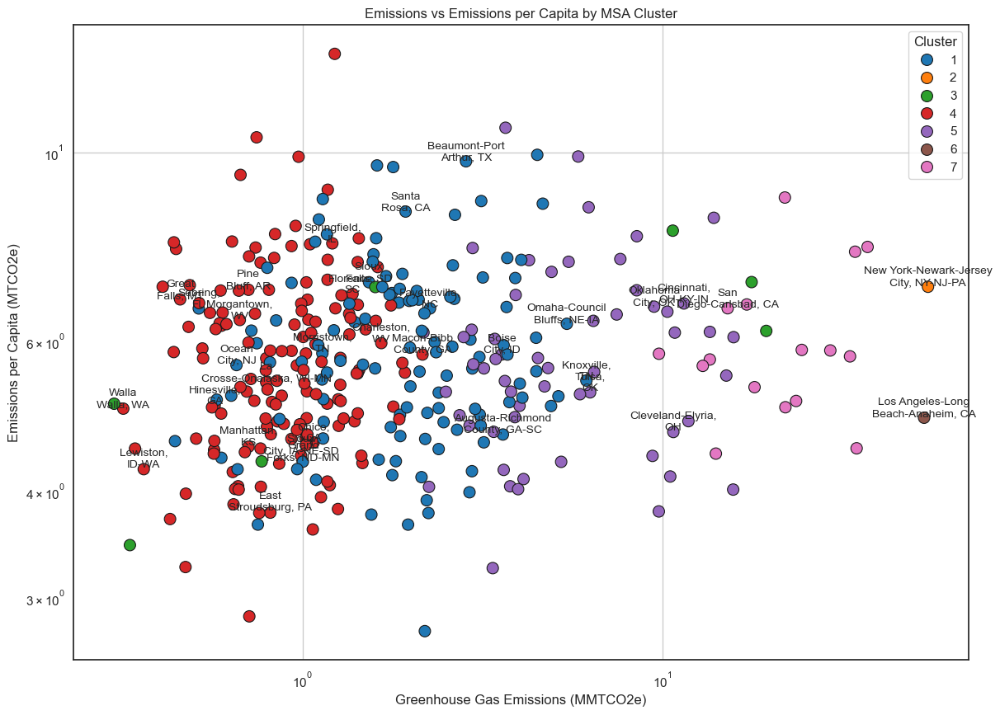

In [15]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming your DataFrame is named 'merged_df'

# Function to split the name into two parts with equal length
def split_name(name):
    words = name.split()
    half = len(words) // 2
    first_part = " ".join(words[:half])
    second_part = " ".join(words[half:])
    return f"{first_part}\n{second_part}"

# Create a scatter plot
plt.figure(figsize=(14, 10))
scatter = sns.scatterplot(
    data=merged_df, 
    x='greenhouse gas emissions (MMTCO2e)', 
    y='Emissions per capita', 
    hue='Cluster', 
    palette='tab10',  # Customize the palette to match your clusters
    s=100,  # size of the points
    edgecolor='k'
)

# Labeling MSAs in Cluster 1 (half), and all in Clusters 2, 6, and half of Clusters 3, 4, 5, 7
def get_half_indices(cluster_values, num_half=10):
    half_indices = []
    for cluster in cluster_values:
        indices = merged_df[merged_df['Cluster'] == cluster].index
        half_indices.extend(indices[:len(indices) // num_half])  # Select half of the indices
    return half_indices

cluster1_indices = merged_df[merged_df['Cluster'] == 1].index
cluster1_half_indices = cluster1_indices[:len(cluster1_indices) // 10]  # Select half of Cluster 1 MSAs

# Get half of the indices for clusters 3, 4, 5, and 7
half_clusters = get_half_indices([3, 4, 5, 7])

# Combine indices
indices_to_label = set(cluster1_half_indices).union(half_clusters)

# Vertical offset to position the text slightly above the scatter dots
vertical_offset = 0.02  # Adjust this value to move the labels higher or lower

for i in range(len(merged_df)):
    city_name = merged_df.iloc[i]['NAME']
    cluster = merged_df.iloc[i]['Cluster']
    
    # Check if the MSA is in the selected clusters
    if i in indices_to_label or cluster in [2, 6]:
        city_name_split = split_name(city_name)  # Split the name into two parts
        
        plt.text(
            merged_df.iloc[i]['greenhouse gas emissions (MMTCO2e)'], 
            merged_df.iloc[i]['Emissions per capita'] + vertical_offset,  # Offset the label slightly above
            city_name_split, 
            fontsize=10, 
            ha='center'  # Center the text horizontally
        )

# Adding labels and title
plt.xlabel('Greenhouse Gas Emissions (MMTCO2e)')
plt.ylabel('Emissions per Capita (MTCO2e)')
plt.title('Emissions vs Emissions per Capita by MSA Cluster')
plt.legend(title='Cluster', loc='upper right')
plt.grid(True)
plt.xscale("log")
plt.yscale("log")
plt.show()


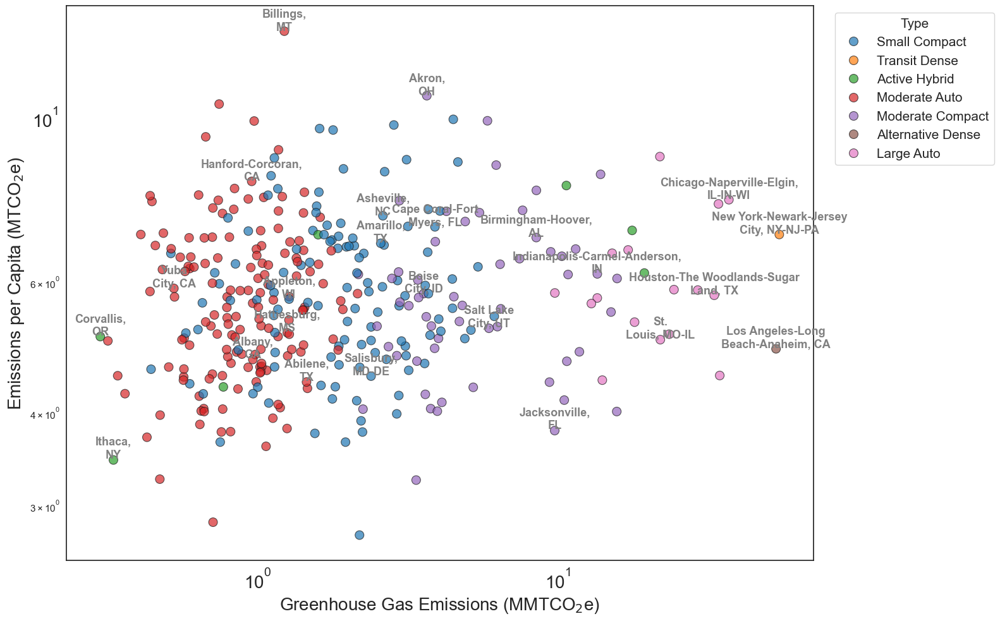

In [16]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming your DataFrame is named 'merged_df'

# Function to split the name into two parts with equal length
def split_name(name):
    words = name.split()
    half = len(words) // 2
    first_part = " ".join(words[:half])
    second_part = " ".join(words[half:])
    return f"{first_part}\n{second_part}"

# List of specific MSAs to label
specific_msas = [
    'Amarillo, TX', 'Appleton, WI', 'Asheville, NC', 'Billings, MT',
    'Cape Coral-Fort Myers, FL', 'New York-Newark-Jersey City, NY-NJ-PA','Los Angeles-Long Beach-Anaheim, CA',
    'Atlanta-Sandy Springs-Alpharetta, GA','Houston-The Woodlands-Sugar Land, TX','San Diego-Chula Vista-Carlsbad, CA',
    'Corvallis, OR', 'Ithaca, NY','Abilene, TX', 'Albany, GA','Yuba City, CA','Hanford-Corcoran, CA', 'Hattiesburg, MS',
    'Akron, OH','Hartford-East Hartford-Middletown, CT','Salt Lake City, UT','Birmingham-Hoover, AL','Boise City, ID','Buffalo-Cheektowaga, NY','Chicago-Naperville-Elgin, IL-IN-WI',
    'Phoenix-Mesa-Chandler, AZ', 'Chicago-Naperville-Elgin, IL-IN-WI','St. Louis, MO-IL','San Diego-Chula Vista-Carlsbad, CA','Salisbury, MD-DE','Indianapolis-Carmel-Anderson, IN','Jacksonville, FL'
]

# Create a scatter plot
plt.figure(figsize=(16, 10))
scatter = sns.scatterplot(
    data=merged_df, 
    x='greenhouse gas emissions (MMTCO2e)', 
    y='Emissions per capita', 
    hue='Cluster', 
    palette='tab10',  # Customize the palette to match your clusters
    s=100,  # Size of the points
    edgecolor='k',
    alpha=0.7  # Increase transparency of the markers
)

# Labeling specific MSAs
# Vertical offset to position the text slightly above the scatter dots
vertical_offset = 0.02  # Adjust this value to move the labels higher or lower

for i in range(len(merged_df)):
    city_name = merged_df.iloc[i]['NAME']
    
    # Check if the MSA is in the list of specific MSAs
    if city_name in specific_msas:
        city_name_split = split_name(city_name)  # Split the name into two parts
        
        plt.text(
            merged_df.iloc[i]['greenhouse gas emissions (MMTCO2e)'], 
            merged_df.iloc[i]['Emissions per capita'] + vertical_offset,  # Offset the label slightly above
            city_name_split, 
            fontsize=13, 
            ha='center',  # Center the text horizontally
            fontweight='bold',
            color='gray'  # Use gray for annotation labels
        )

cluster_labels = [
    'Small Compact', 
    'Transit Dense', 
    'Active Hybrid', 
    'Moderate Auto', 
    'Moderate Compact', 
    'Alternative Dense', 
    'Large Auto'
]

# Create a legend with the custom labels
handles, _ = scatter.get_legend_handles_labels()
plt.legend(
    handles=handles,
    labels=cluster_labels,
    title='Type',
    bbox_to_anchor=(1.02, 1),  # Position the legend outside the plot
    loc='upper left',
    fontsize=15,
    title_fontsize='15' 
)

# Adjust the size of the x and y ticks labels
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

# Adding labels and title
plt.xlabel('Greenhouse Gas Emissions (MMTCO$_2$e)', fontsize=20)
plt.ylabel('Emissions per Capita (MTCO$_2$e)', fontsize=20)
plt.xscale("log")
plt.yscale("log")
plt.tight_layout()  # Ensure everything fits well in the figure area
plt.savefig('../../figures/clusterplot.jpg', dpi=600, bbox_inches='tight', pad_inches=0)


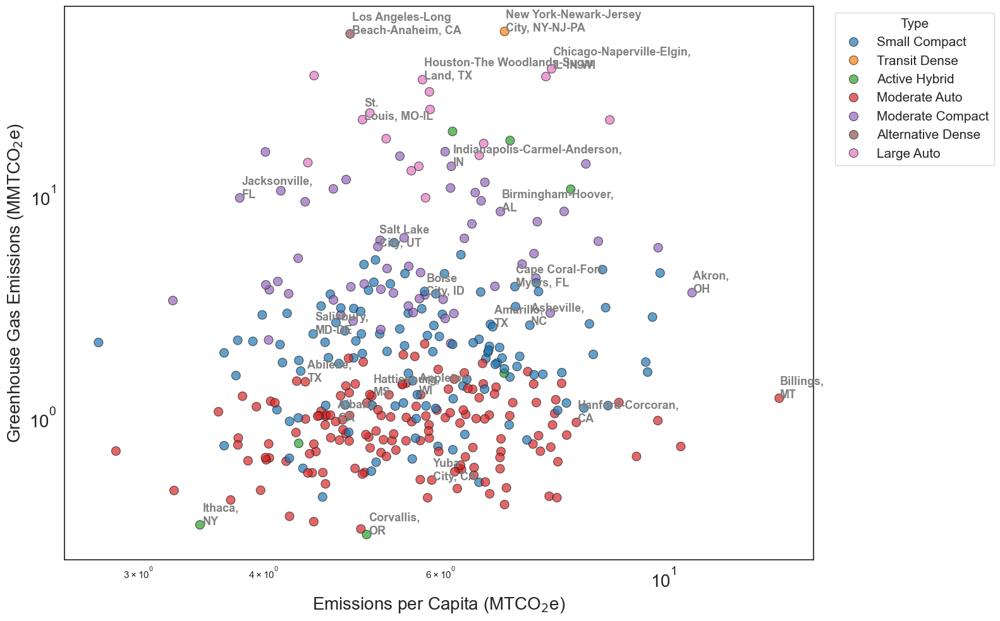

In [17]:
import matplotlib.pyplot as plt
import seaborn as sns

# Function to split the name into two parts with equal length
def split_name(name):
    words = name.split()
    half = len(words) // 2
    first_part = " ".join(words[:half])
    second_part = " ".join(words[half:])
    return f"{first_part}\n{second_part}"

# List of specific MSAs to label
specific_msas = [
    'Amarillo, TX', 'Appleton, WI', 'Asheville, NC', 'Billings, MT',
    'Cape Coral-Fort Myers, FL', 'New York-Newark-Jersey City, NY-NJ-PA','Los Angeles-Long Beach-Anaheim, CA',
    'Atlanta-Sandy Springs-Alpharetta, GA','Houston-The Woodlands-Sugar Land, TX','San Diego-Chula Vista-Carlsbad, CA',
    'Corvallis, OR', 'Ithaca, NY','Abilene, TX', 'Albany, GA','Yuba City, CA','Hanford-Corcoran, CA', 'Hattiesburg, MS',
    'Akron, OH','Hartford-East Hartford-Middletown, CT','Salt Lake City, UT','Birmingham-Hoover, AL','Boise City, ID','Buffalo-Cheektowaga, NY','Chicago-Naperville-Elgin, IL-IN-WI',
    'Phoenix-Mesa-Chandler, AZ', 'Chicago-Naperville-Elgin, IL-IN-WI','St. Louis, MO-IL','San Diego-Chula Vista-Carlsbad, CA','Salisbury, MD-DE','Indianapolis-Carmel-Anderson, IN','Jacksonville, FL'
]

# Create a scatter plot with x and y axes flipped
plt.figure(figsize=(16, 10))
scatter = sns.scatterplot(
    data=merged_df, 
    x='Emissions per capita',  # Swap x with y
    y='greenhouse gas emissions (MMTCO2e)',  # Swap y with x
    hue='Cluster', 
    palette='tab10',  # Customize the palette to match your clusters
    s=100,  # Size of the points
    edgecolor='k',
    alpha=0.7  # Increase transparency of the markers
)

# Labeling specific MSAs
# Vertical offset to position the text slightly to the right of the scatter dots
horizontal_offset = 0.02  # Adjust this value to move the labels slightly to the right

for i in range(len(merged_df)):
    city_name = merged_df.iloc[i]['NAME']
    
    # Check if the MSA is in the list of specific MSAs
    if city_name in specific_msas:
        city_name_split = split_name(city_name)  # Split the name into two parts
        
        plt.text(
            merged_df.iloc[i]['Emissions per capita'] + horizontal_offset,  # Offset the label slightly to the right
            merged_df.iloc[i]['greenhouse gas emissions (MMTCO2e)'], 
            city_name_split, 
            fontsize=13, 
            ha='left',  # Align the text horizontally to the left
            fontweight='bold',
            color='gray'  # Use gray for annotation labels
        )

cluster_labels = [
    'Small Compact', 
    'Transit Dense', 
    'Active Hybrid', 
    'Moderate Auto', 
    'Moderate Compact', 
    'Alternative Dense', 
    'Large Auto'
]

# Create a legend with the custom labels
handles, _ = scatter.get_legend_handles_labels()
plt.legend(
    handles=handles,
    labels=cluster_labels,
    title='Type',
    bbox_to_anchor=(1.02, 1),  # Position the legend outside the plot
    loc='upper left',
    fontsize=15,
    title_fontsize='15' 
)

# Adjust the size of the x and y ticks labels
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

# Adding labels and title, with flipped axes
plt.xlabel('Emissions per Capita (MTCO$_2$e)', fontsize=20)  # Swap x label with y label
plt.ylabel('Greenhouse Gas Emissions (MMTCO$_2$e)', fontsize=20)  # Swap y label with x label
plt.xscale("log")  # Log scale on the flipped x-axis
plt.yscale("log")  # Log scale on the flipped y-axis
plt.tight_layout()  # Ensure everything fits well in the figure area
plt.savefig('../../figures/clusterplot.jpg', dpi=600, bbox_inches='tight', pad_inches=0)


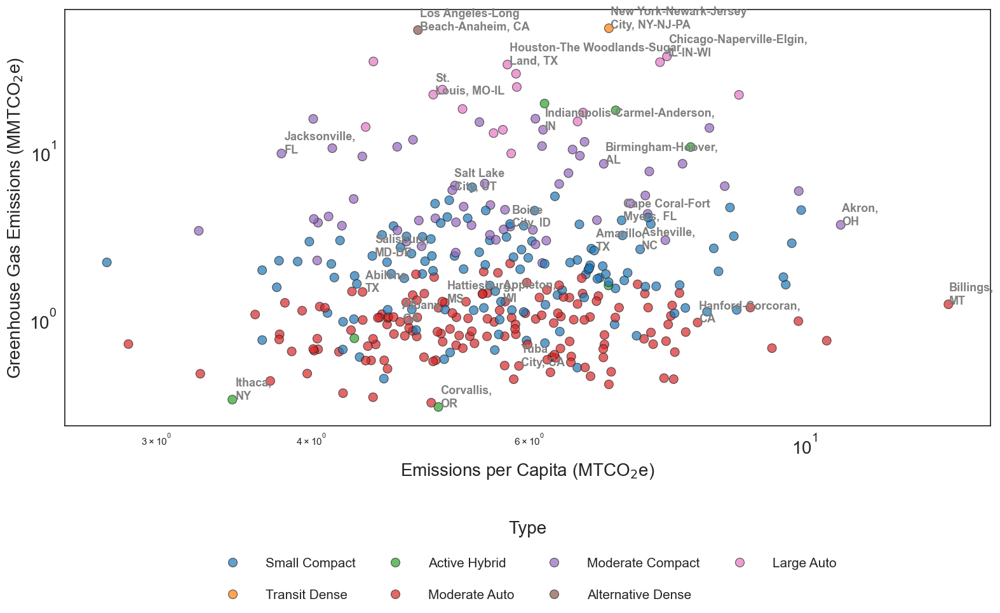

In [18]:
import matplotlib.pyplot as plt
import seaborn as sns

# Function to split the name into two parts with equal length
def split_name(name):
    words = name.split()
    half = len(words) // 2
    first_part = " ".join(words[:half])
    second_part = " ".join(words[half:])
    return f"{first_part}\n{second_part}"

# List of specific MSAs to label
specific_msas = [
    'Amarillo, TX', 'Appleton, WI', 'Asheville, NC', 'Billings, MT',
    'Cape Coral-Fort Myers, FL', 'New York-Newark-Jersey City, NY-NJ-PA','Los Angeles-Long Beach-Anaheim, CA',
    'Atlanta-Sandy Springs-Alpharetta, GA','Houston-The Woodlands-Sugar Land, TX','San Diego-Chula Vista-Carlsbad, CA',
    'Corvallis, OR', 'Ithaca, NY','Abilene, TX', 'Albany, GA','Yuba City, CA','Hanford-Corcoran, CA', 'Hattiesburg, MS',
    'Akron, OH','Hartford-East Hartford-Middletown, CT','Salt Lake City, UT','Birmingham-Hoover, AL','Boise City, ID','Buffalo-Cheektowaga, NY','Chicago-Naperville-Elgin, IL-IN-WI',
    'Phoenix-Mesa-Chandler, AZ', 'Chicago-Naperville-Elgin, IL-IN-WI','St. Louis, MO-IL','San Diego-Chula Vista-Carlsbad, CA','Salisbury, MD-DE','Indianapolis-Carmel-Anderson, IN','Jacksonville, FL'
]

# Create a scatter plot with x and y axes flipped
plt.figure(figsize=(16, 10))
scatter = sns.scatterplot(
    data=merged_df, 
    x='Emissions per capita',  # Swap x with y
    y='greenhouse gas emissions (MMTCO2e)',  # Swap y with x
    hue='Cluster', 
    palette='tab10',  # Customize the palette to match your clusters
    s=100,  # Size of the points
    edgecolor='k',
    alpha=0.7  # Increase transparency of the markers
)

# Labeling specific MSAs
# Vertical offset to position the text slightly to the right of the scatter dots
horizontal_offset = 0.02  # Adjust this value to move the labels slightly to the right

for i in range(len(merged_df)):
    city_name = merged_df.iloc[i]['NAME']
    
    # Check if the MSA is in the list of specific MSAs
    if city_name in specific_msas:
        city_name_split = split_name(city_name)  # Split the name into two parts
        
        plt.text(
            merged_df.iloc[i]['Emissions per capita'] + horizontal_offset,  # Offset the label slightly to the right
            merged_df.iloc[i]['greenhouse gas emissions (MMTCO2e)'], 
            city_name_split, 
            fontsize=13, 
            ha='left',  # Align the text horizontally to the left
            fontweight='bold',
            color='gray'  # Use gray for annotation labels
        )

cluster_labels = [
    'Small Compact', 
    'Transit Dense', 
    'Active Hybrid', 
    'Moderate Auto', 
    'Moderate Compact', 
    'Alternative Dense', 
    'Large Auto'
]

# Create a legend with the custom labels, positioned horizontally below the plot
handles, _ = scatter.get_legend_handles_labels()
plt.legend(
    handles=handles,
    labels=cluster_labels,
    title='Type',
    bbox_to_anchor=(0.5, -0.2),  # Position the legend below the plot
    loc='upper center',
    fontsize=15,
    title_fontsize='20',
    ncol=4,  # Display the legend in 3 columns for a horizontal layout
    frameon=False,
    labelspacing=1.5,
    handlelength=2,  # Length of the legend handles
    handletextpad=1.5
)

# Adjust the size of the x and y ticks labels
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

# Adding labels and title, with flipped axes
plt.xlabel('Emissions per Capita (MTCO$_2$e)', fontsize=20)  # Swap x label with y label
plt.ylabel('Greenhouse Gas Emissions (MMTCO$_2$e)', fontsize=20)  # Swap y label with x label
plt.xscale("log")  # Log scale on the flipped x-axis
plt.yscale("log")  # Log scale on the flipped y-axis
plt.tight_layout()  # Ensure everything fits well in the figure area
plt.savefig('../../figures/clusterplot.jpg', dpi=600, bbox_inches='tight', pad_inches=0)


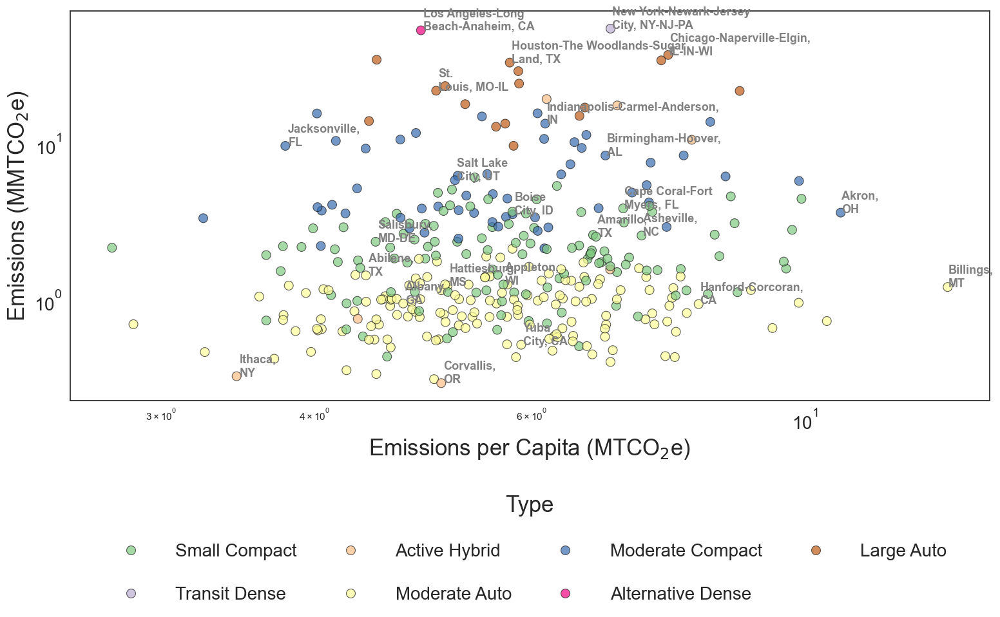

In [24]:
import matplotlib.pyplot as plt
import seaborn as sns

# Function to split the name into two parts with equal length
def split_name(name):
    words = name.split()
    half = len(words) // 2
    first_part = " ".join(words[:half])
    second_part = " ".join(words[half:])
    return f"{first_part}\n{second_part}"

# List of specific MSAs to label
specific_msas = [
    'Amarillo, TX', 'Appleton, WI', 'Asheville, NC', 'Billings, MT',
    'Cape Coral-Fort Myers, FL', 'New York-Newark-Jersey City, NY-NJ-PA','Los Angeles-Long Beach-Anaheim, CA',
    'Atlanta-Sandy Springs-Alpharetta, GA','Houston-The Woodlands-Sugar Land, TX','San Diego-Chula Vista-Carlsbad, CA',
    'Corvallis, OR', 'Ithaca, NY','Abilene, TX', 'Albany, GA','Yuba City, CA','Hanford-Corcoran, CA', 'Hattiesburg, MS',
    'Akron, OH','Hartford-East Hartford-Middletown, CT','Salt Lake City, UT','Birmingham-Hoover, AL','Boise City, ID','Buffalo-Cheektowaga, NY','Chicago-Naperville-Elgin, IL-IN-WI',
    'Phoenix-Mesa-Chandler, AZ', 'Chicago-Naperville-Elgin, IL-IN-WI','St. Louis, MO-IL','San Diego-Chula Vista-Carlsbad, CA','Salisbury, MD-DE','Indianapolis-Carmel-Anderson, IN','Jacksonville, FL'
]

# Custom color palette for clusters
custom_palette = ['#7fc97f', '#beaed4', '#fdc086', '#ffff99', '#386cb0', '#f0027f', '#bf5b17']

# Mapping cluster numbers to descriptive names
cluster_mapping = {
    1: 'Small Compact',
    2: 'Transit Dense',
    3: 'Active Hybrid',
    4: 'Moderate Auto',
    5: 'Moderate Compact',
    6: 'Alternative Dense',
    7: 'Large Auto'
}

# Map colors to clusters
cluster_colors = dict(zip(cluster_mapping.keys(), custom_palette))

# Apply the mapping to the 'Cluster' column in your DataFrame
merged_df['Cluster Name'] = merged_df['Cluster'].map(cluster_mapping)

# Create a scatter plot with x and y axes flipped
plt.figure(figsize=(16, 10))
scatter = sns.scatterplot(
    data=merged_df, 
    x='Emissions per capita',  # Swap x with y
    y='greenhouse gas emissions (MMTCO2e)',  # Swap y with x
    hue='Cluster', 
    palette=cluster_colors,  # Apply custom color palette
    s=100,  # Size of the points
    edgecolor='k',
    alpha=0.7  # Increase transparency of the markers
)

# Labeling specific MSAs
# Vertical offset to position the text slightly to the right of the scatter dots
horizontal_offset = 0.02  # Adjust this value to move the labels slightly to the right

for i in range(len(merged_df)):
    city_name = merged_df.iloc[i]['NAME']
    
    # Check if the MSA is in the list of specific MSAs
    if city_name in specific_msas:
        city_name_split = split_name(city_name)  # Split the name into two parts
        
        plt.text(
            merged_df.iloc[i]['Emissions per capita'] + horizontal_offset,  # Offset the label slightly to the right
            merged_df.iloc[i]['greenhouse gas emissions (MMTCO2e)'], 
            city_name_split, 
            fontsize=13, 
            ha='left',  # Align the text horizontally to the left
            fontweight='bold',
            color='gray'  # Use gray for annotation labels
        )

# Create a legend with the custom labels, positioned horizontally below the plot
handles, _ = scatter.get_legend_handles_labels()
plt.legend(
    handles=handles,
    labels=[cluster_mapping[i] for i in sorted(cluster_mapping.keys())],
    title='Type',
    bbox_to_anchor=(0.5, -0.2),  # Position the legend below the plot
    loc='upper center',
    fontsize=20,
    title_fontsize='25',
    ncol=4,  # Display the legend in 3 columns for a horizontal layout
    frameon=False,
    labelspacing=1.5,
    handlelength=2,  # Length of the legend handles
    handletextpad=1.5
)

# Adjust the size of the x and y ticks labels
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

# Adding labels and title, with flipped axes
plt.xlabel('Emissions per Capita (MTCO$_2$e)', fontsize=25)  # Swap x label with y label
plt.ylabel('Emissions (MMTCO$_2$e)', fontsize=25)  # Swap y label with x label
plt.xscale("log")  # Log scale on the flipped x-axis
plt.yscale("log")  # Log scale on the flipped y-axis
plt.tight_layout()  # Ensure everything fits well in the figure area
plt.savefig('../../figures/clusterplot.jpg', dpi=600, bbox_inches='tight', pad_inches=0)


NameError: name 'raw' is not defined

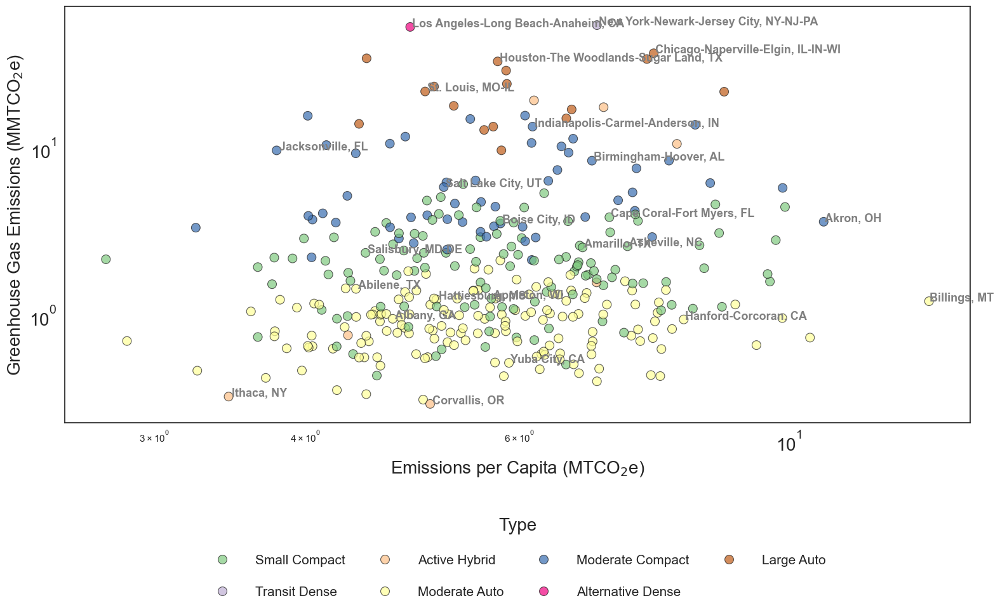

In [20]:
import matplotlib.pyplot as plt
import seaborn as sns

# List of specific MSAs to label
specific_msas = [
    'Amarillo, TX', 'Appleton, WI', 'Asheville, NC', 'Billings, MT',
    'Cape Coral-Fort Myers, FL', 'New York-Newark-Jersey City, NY-NJ-PA',
    'Los Angeles-Long Beach-Anaheim, CA', 'Atlanta-Sandy Springs-Alpharetta, GA',
    'Houston-The Woodlands-Sugar Land, TX', 'San Diego-Chula Vista-Carlsbad, CA',
    'Corvallis, OR', 'Ithaca, NY', 'Abilene, TX', 'Albany, GA', 'Yuba City, CA',
    'Hanford-Corcoran, CA', 'Hattiesburg, MS', 'Akron, OH', 'Hartford-East Hartford-Middletown, CT',
    'Salt Lake City, UT', 'Birmingham-Hoover, AL', 'Boise City, ID', 'Buffalo-Cheektowaga, NY',
    'Chicago-Naperville-Elgin, IL-IN-WI', 'Phoenix-Mesa-Chandler, AZ', 'St. Louis, MO-IL',
    'San Diego-Chula Vista-Carlsbad, CA', 'Salisbury, MD-DE', 'Indianapolis-Carmel-Anderson, IN', 'Jacksonville, FL'
]

# Define your custom color palette for the clusters
custom_palette = ['#7fc97f', '#beaed4', '#fdc086', '#ffff99', '#386cb0', '#f0027f', '#bf5b17']

# Mapping cluster numbers to descriptive names
cluster_mapping = {
    1: 'Small Compact',
    2: 'Transit Dense',
    3: 'Active Hybrid',
    4: 'Moderate Auto',
    5: 'Moderate Compact',
    6: 'Alternative Dense',
    7: 'Large Auto'
}

# Map colors to clusters
cluster_colors = dict(zip(cluster_mapping.keys(), custom_palette))

# Create a scatter plot with x and y axes flipped
plt.figure(figsize=(16, 10))
scatter = sns.scatterplot(
    data=merged_df, 
    x='Emissions per capita',  # Swap x with y
    y='greenhouse gas emissions (MMTCO2e)',  # Swap y with x
    hue='Cluster', 
    palette=cluster_colors,  # Use the custom color palette
    s=100,  # Size of the points
    edgecolor='k',
    alpha=0.7  # Increase transparency of the markers
)

# Labeling specific MSAs
# Vertical offset to position the text slightly to the right of the scatter dots
horizontal_offset = 0.02  # Adjust this value to move the labels slightly to the right

for i in range(len(merged_df)):
    city_name = merged_df.iloc[i]['NAME']
    
    # Check if the MSA is in the list of specific MSAs
    if city_name in specific_msas:
        plt.text(
            merged_df.iloc[i]['Emissions per capita'] + horizontal_offset,  # Offset the label slightly to the right
            merged_df.iloc[i]['greenhouse gas emissions (MMTCO2e)'], 
            city_name,  # Keep the city name on one line
            fontsize=13, 
            ha='left',  # Align the text horizontally to the left
            fontweight='bold',
            color='gray'  # Use gray for annotation labels
        )

# Create a legend with the custom labels, positioned horizontally below the plot
handles, _ = scatter.get_legend_handles_labels()
plt.legend(
    handles=handles,
    labels=[cluster_mapping[i] for i in range(1, 8)],  # Ensure the legend matches the correct cluster order
    title='Type',
    bbox_to_anchor=(0.5, -0.2),  # Position the legend below the plot
    loc='upper center',
    fontsize=15,
    title_fontsize='20',
    ncol=4,  # Display the legend in 4 columns for a horizontal layout
    frameon=False,
    labelspacing=1.5,
    handlelength=2,  # Length of the legend handles
    handletextpad=1.5
)

# Adjust the size of the x and y ticks labels
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

# Adding labels and title, with flipped axes
plt.xlabel('Emissions per Capita (MTCO$_2$e)', fontsize=20)  # Swap x label with y label
plt.ylabel('Greenhouse Gas Emissions (MMTCO$_2$e)', fontsize=20)  # Swap y label with x label
plt.xscale("log")  # Log scale on the flipped x-axis
plt.yscale("log")  # Log scale on the flipped y-axis
plt.tight_layout()  # Ensure everything fits well in the figure area
plt.savefig('../../figures/clusterplot.jpg', dpi=600, bbox_inches='tight', pad_inches=0)

# Second plot setup
columns_to_plot = ['Population', 'Housing Units', '3 or more vehicles available', 'Node Count']

# Apply the mapping to the 'Cluster' column in your DataFrame
raw['Cluster Name'] = raw['Cluster'].map(cluster_mapping)

# Ensure no NaNs in 'Cluster' and 'Emissions per capita'
raw_clean = raw.dropna(subset=['Cluster', 'carbon dioxide equivalent (MMTCO2e)'])

# Convert the DataFrame to long format for easier plotting
melted_df = raw_clean.melt(id_vars=['Cluster', 'Cluster Name', 'carbon dioxide equivalent (MMTCO2e)'], 
                           value_vars=columns_to_plot, 
                           var_name='Variable', 
                           value_name='Value')

# Create the FacetGrid with scatter plots for each variable
g = sns.FacetGrid(melted_df, col='Variable', col_wrap=2, height=4, aspect=1.5, 
                  hue='Cluster', palette=cluster_colors, sharex=False)

# Map the scatterplot to the grid
g.map(sns.scatterplot, 'Value', 'carbon dioxide equivalent (MMTCO2e)', edgecolor='black', alpha=0.8, s=100)

# Set log scales for the x and y axes
g.set(xscale='log', yscale='log')

# Add the legend manually to ensure cluster names are used
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=cluster_colors[k], markersize=10, label=cluster_mapping[k]) for k in cluster_mapping]
g.fig.legend(handles=handles, bbox_to_anchor=(0.5, -0.01), loc='upper center', ncol=4, fontsize=15, frameon=False, title="Type", title_fontsize=15, labelspacing=1)

# Set axis labels and plot titles
g.set_axis_labels('', 'Emissions (MMTCO$_2$e)', fontsize=15)
g.set_titles(col_template='{col_name}', size=15, y=1.05)  # Adjust y to move the titles higher

# Adjust the layout: increase space between plots and title-x-axis
g.fig.subplots_adjust(top=0.9, bottom=0.1, wspace=0.3, hspace=0.4)  # wspace and hspace control space between plots

# Save the figure with bbox_inches='tight'
plt.savefig('../../figures/variable-emissions-scatter.jpg', dpi=600, bbox_inches='tight')
